In [1]:
import torch
from diffusers import StableDiffusion3ControlNetPipeline, SD3ControlNetModel
from diffusers.utils import load_image
import gc
import os
import wandb

In [ ]:
TARGET_WIDTH = 720
TARGET_HEIGHT = 1280
# CHECKPOINTS = [2500, 3750, 5000, 6250, 7500, 8750, 10000, 11250, 12500]
CHECKPOINTS = [5000, 6250, 7500, 8750]

base_model = "stabilityai/stable-diffusion-3.5-large"
CHECKPOINT_ROOT = '/scratch/delineo_data/.bkp'

def get_checkpoint_path(steps: int) -> str:
  return f'{CHECKPOINT_ROOT}/checkpoint-{steps}/controlnet'

In [ ]:
import math
import matplotlib.pyplot as plt
# Experiment params

# [0]: prompt, [1]: image path
example_pairs = [
  ("High-fidelity single screen mobile app UI design with no border, full screen view of a registration screen. Features a prominent 'EasyBox' logo in blue and orange at the top. Below is a stacked form with input fields for Name, Email, Password, and Confirm Password. Includes a Terms of Use agreement checkbox and a solid blue primary submit button. Clean and modern aesthetic.", "/scratch/delineo_data/validation/408_input.png"),
  ("High-fidelity single screen mobile app UI design with no border, full screen edge-to-edge view of the T&M e-commerce main page. Large carousel features studio quality photography of ultra realistic fashion models with flawless features and trendy outfits. Below are extra large, distinct banner sections for 'Women' and 'Men' categories. A thin, prominent banner displays 'Last Day of Festival Shop - 50% OFF'. The overall aesthetic is minimalist, clean, modern, and uses a professional color palette.", "/scratch/delineo_data/validation/4240_1_input.png"),
  ("High-fidelity single screen mobile UI, edge-to-edge immersive view, no borders. Luxury vacation rental discovery feed. The interface is dominated by a vertical stack of extra-large, bleeding-edge photographs of stunning villas. The top search bar is transparent and integrated over the first image with white text 'Location | Dates'. Information is overlaid directly onto the bottom of each large photo card using subtle gradients for readability: White text for property name, a bold price '$850 / night' and a small star icon rating. Ultra-minimalist, premium feel, clean interface.", "/scratch/delineo_data/validation/12922_2_input.png"),
  ("High-fidelity single screen mobile app UI design, edge-to-edge immersive view, no borders. A modern local experiences promotions feed. At the top, a clean, floating search bar pill with a magnifying glass icon and placeholder text 'Search experiences...'. Below it, a horizontal scrolling row of four circular category buttons with vivid photographic icons and labels below them: 'Goods', 'Tourism', 'Beauty', 'Concerts'. The main content is a smooth vertical scroll of massive, full-width offer cards with rounded corners and soft drop shadows. Each card features a stunning, high-resolution vibrant marketing photo, a bold property title, a short descriptive subtitle below the title, a location pin icon with text, and a prominent price badge. Minimalist aesthetic, clean interface", "/scratch/delineo_data/validation/56563_3_input.png"),
]

NEGATIVE_PROMPT = "grid, collage, too many images, too many cards, split screen, floating screenshot, multiple views, tiling, low quality, ugly, blurry, unnatural, unprofessional, poorly composed, deformed, noisy text, phone frame, bezel, device frame, smartphone mockup, outer margin, screenshot interface, deformed body, disfigured, poorly drawn face, bad anatomy, extra limbs, malformed hands, missing limbs, floating limbs, disconnected limbs, mutation, mutated, disgusting, amputation"

INFERENCE_STEPS = [80]
CONTROL_STRENGTHS = [0.75]
GUIDANCE_SCALE = [8]

def show_checkpoint_results(images, labels, title):
    num_images = len(images)
    cols = 4
    rows = math.ceil(num_images / cols)
    w_per_col = 6 
    h_per_row = 10
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * w_per_col, rows * h_per_row))
    fig.suptitle(title, fontsize=20, y=1.02) # Move title up slightly
    
    if rows == 1 and cols == 1:
        axes = [axes]
    else:
        axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < num_images:
            # Show image
            ax.imshow(images[i])
            ax.set_title(labels[i], fontsize=12, pad=10)
            
            # Remove ticks/spines for a clean look
            ax.axis("off")
        else:
            # 3. HIDE unused subplots (The empty boxes at the bottom)
            ax.axis("off")
            ax.set_visible(False)

    plt.tight_layout()
    plt.show()

In [4]:
import wandb

run = wandb.init('programendes', project="delineo", name="experiment-run-6")
columns = ["Checkpoint", "Control Strength", "Steps", "Guidance", "Image"]
results_table = wandb.Table(columns=columns)

wandb: Currently logged in as: matheus-iba2012 (programendes) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


--- Processing: checkpoint-3750 ---


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

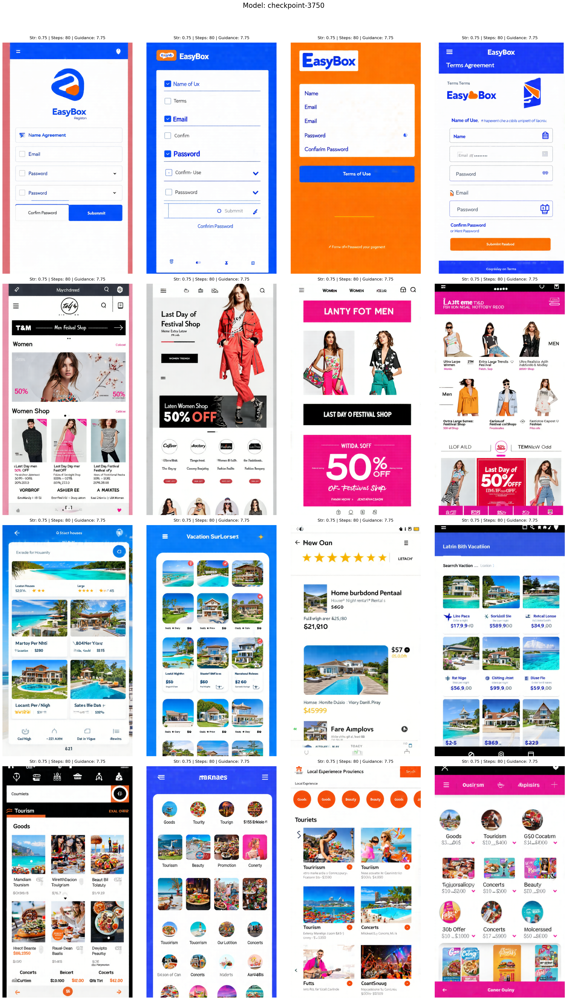

--- Processing: checkpoint-5000 ---


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

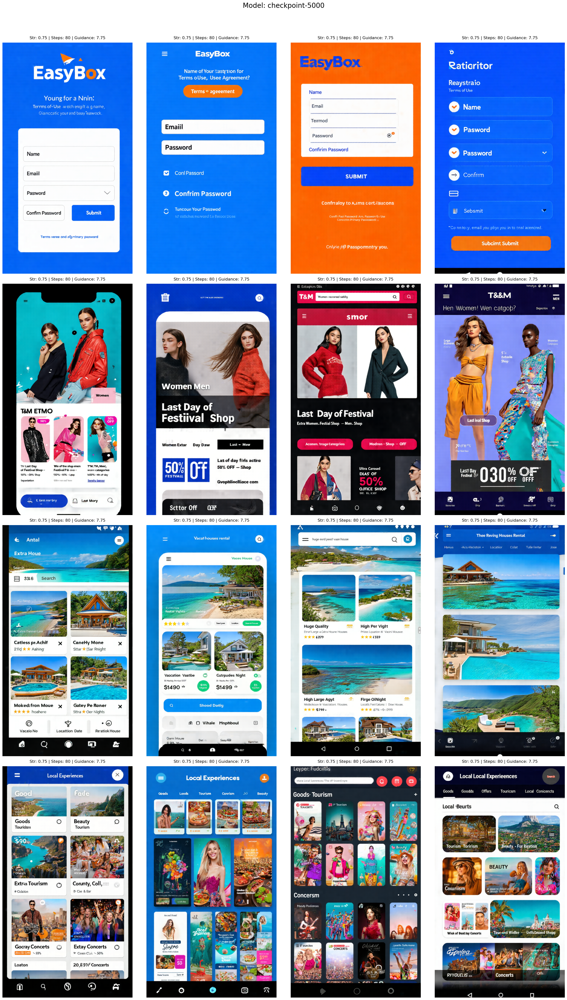

--- Processing: checkpoint-6250 ---


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

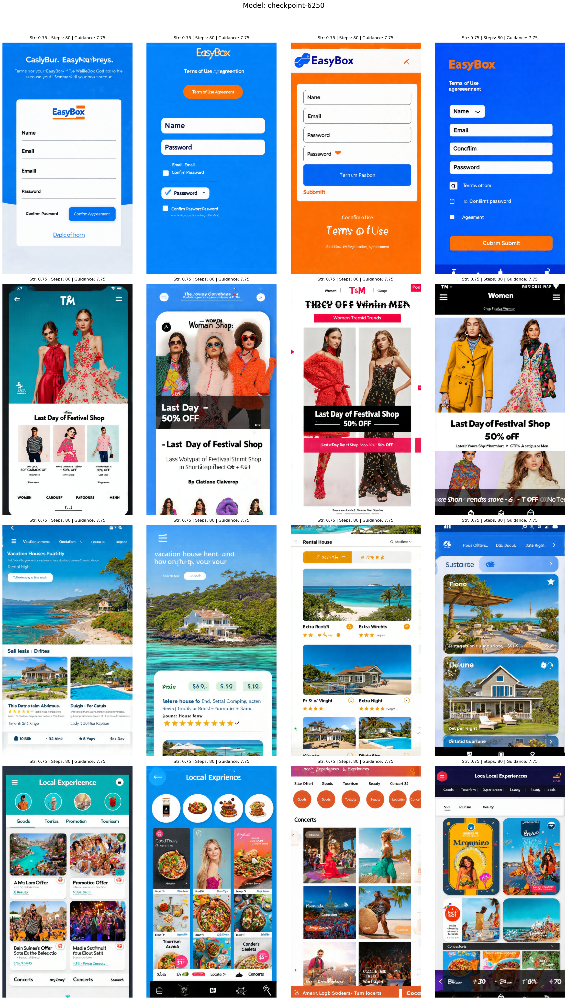

--- Processing: checkpoint-7500 ---


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
import random

for steps in CHECKPOINTS:
    model_id = f'checkpoint-{steps}'
    batch_images = []
    batch_labels = []
    print(f"--- Processing: {model_id} ---")
    
    # Load Model
    controlnet = SD3ControlNetModel.from_pretrained(get_checkpoint_path(steps), torch_dtype=torch.bfloat16)
    pipe = StableDiffusion3ControlNetPipeline.from_pretrained(
        base_model, controlnet=controlnet, torch_dtype=torch.bfloat16
    ).to("cuda")
    pipe.set_progress_bar_config(disable=True)


    for example_pair in example_pairs:
        control_image = load_image(example_pair[1])
        for guidance in GUIDANCE_SCALE:
            for steps in INFERENCE_STEPS:
                for strength in CONTROL_STRENGTHS:
                    for i in range(4):
                        seed = 42 + i**2
                        
                        generator = torch.Generator("cuda").manual_seed(seed)
                        image = pipe(
                            prompt=example_pair[0],
                            control_image=control_image,
                            height=TARGET_HEIGHT,
                            width=TARGET_WIDTH,
                            num_inference_steps=steps,
                            controlnet_conditioning_scale=strength,
                            generator=generator,
                            negative_prompt=NEGATIVE_PROMPT,
                            guidance_scale=guidance
                        ).images[0] # type: ignore

                        results_table.add_data(model_id, strength, steps, guidance, wandb.Image(image))
                        batch_images.append(image)
                        batch_labels.append(f"Str: {strength} | Steps: {steps} | Guidance: {guidance}")

    show_checkpoint_results(batch_images, batch_labels, title=f"Model: {model_id}")

    # Cleanup
    del pipe, controlnet, batch_images
    torch.cuda.empty_cache()
    gc.collect()

# --- 4. Finish ---
run.log({"comparison_grid": results_table})
run.finish()